In [2]:
import dask
import hest
print(hest.__version__)
from hest.HESTData import read_HESTData
from pathlib import Path
import torch

import warnings
import numpy as np
import tifffile as tiff

from hestcore.wsi import NumpyWSI
import scanpy as sc

import matplotlib.pyplot as plt
from PIL import Image

import math

# cutomised function
from gutdecoder.wrappers.segment_wrapper import *

0.0.1


## test

In [9]:
save_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR4/slide1/ROI1")
R4S1R1 = read_HESTData(adata_path=f'{save_dir}/aligned_adata.h5ad',                                    
    img=f'{save_dir}/aligned_fullres_HE.tif',                                          
    metrics_path=f'{save_dir}/metrics.json')
R4S1R1

/home/k/kxu/.local/lib/python3.11/site-packages/hestcore/wsi.py:27: UserWarning: CuImage is not available. Ensure you have a GPU and cucim installed to use GPU acceleration.
  warnings.warn("CuImage is not available. Ensure you have a GPU and cucim installed to use GPU acceleration.")


        'pixel_size' is 0.2204614972252983
        'wsi' is <width=21763, height=23864, backend=OpenSlideWSI>
        'shapes': []

In [3]:
# adata = R1S1R1.adata
# print('\n* Scanpy adata:')
# print(adata)

# # WSI:
# wsi = R1S1R1.wsi
# print('\n* WSI:')
# print(wsi)

# # Shapes:
# shapes = R1S1R1.shapes
# print('\n* Shapes:')
# print(shapes)


* Scanpy adata:
AnnData object with n_obs × n_vars = 22171 × 9655
    obs: 'in_tissue', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'array_col', 'array_row', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

* WSI:
<width=8851, height=8585, backend=CuImageWSI>

* Shapes:
[]


## Segmentation

We integrated 2 tissue segmentation methods:

- Image processing-based using Otsu thresholding
- Deep learning-based using a fine-tuned DeepLabV3 ResNet50

### Test code

In [15]:
# name = 'tissue_seg_otsu'
# R1S1R1.segment_tissue(method='otsu') 
# R1S1R1.save_tissue_seg_pkl(save_dir, name)
# R1S1R1.save_tissue_contours(save_dir, name)
# R1S1R1.save_tissue_vis(save_dir, name)

/tmp/ipykernel_4186408/3323706138.py:3: DeprecationWarning: Call to deprecated function save_tissue_seg_pkl.
  R1S1R1.save_tissue_seg_pkl(save_dir, name)
/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:437: DeprecationWarning: Call to deprecated function get_tissue_contours.
  asset_dict = self.get_tissue_contours()
/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/pyogrio/raw.py:698: UserWarning: 'crs' was not provided.  The output dataset will not have projection information defined and may not be usable in other systems.
  warnings.warn(


In [23]:
name = 'deep'
R4S1R1.segment_tissue(method='deep',target_pxl_size=0.5,num_workers=16) # better resolution than target_pxl_size = 1

/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/amp/autocast_mode.py:266: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
100%|██████████| 50/50 [08:56<00:00, 10.73s/it]


,tissue_id,geometry
0,0,"POLYGON ((14080 19943, 14067 19955, 14055 1995..."
1,1,"POLYGON ((11312 14506, 11300 14518, 11312 1453..."
2,2,"POLYGON ((6997 12323.9, 6996.99 12323.9, 6996...."
3,3,"POLYGON ((18261 9849, 18261 9862, 18249 9874, ..."
4,4,"POLYGON ((18322 9472, 18334 9472, 18346 9484, ..."
5,5,"POLYGON ((10118 3522.9, 10117.991 3522.9, 1011..."
6,6,"POLYGON ((14116 3448.9, 14115.99 3448.901, 141..."
7,7,"POLYGON ((12397 2438, 12385 2450, 12373 2450, ..."


In [24]:
name = 'deep'
R4S1R1.save_tissue_contours(save_dir, name)
R4S1R1.save_tissue_vis(save_dir, name)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/pyogrio/raw.py:698: UserWarning: 'crs' was not provided.  The output dataset will not have projection information defined and may not be usable in other systems.
  warnings.warn(


In [5]:
# R1S1R1.save_tissue_contours(save_dir, name)
# R1S1R1.save_tissue_vis(save_dir, name)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/pyogrio/raw.py:698: UserWarning: 'crs' was not provided.  The output dataset will not have projection information defined and may not be usable in other systems.
  warnings.warn(


Result using deep learning is much better than otsu 

# Broad Data

Broad Data has not undergone organise HEST so it is the direct output from HEST

In [4]:
def load_hest_sample(sample_dir: Path):
    """
    Load a HEST sample from a Xenium sample folder.

    Args:
        sample_dir (Path): Path to sample folder containing aligned_adata.h5ad, 
                           aligned_fullres_HE.tif, and aligned_cells.

    Returns:
        st (HESTSample): Loaded HEST sample object.
    """
    sample_dir = Path(sample_dir)

    # files
    adata_path = sample_dir / "aligned_adata.h5ad"
    image_path = sample_dir / "aligned_fullres_HE.tif"
    cells_path = sample_dir / "aligned_cells.h5ad"
    metrics_path = sample_dir / "metrics.json"
    
    # Look for any .geojson under tissue_seg
    tissue_seg_dir = sample_dir / "tissue_seg"
    geojson_files = list(tissue_seg_dir.glob("*.geojson")) if tissue_seg_dir.exists() else []
    tissue_contours_path = geojson_files[0] if geojson_files else None

    if not adata_path.exists():
        raise FileNotFoundError(f"Missing {adata_path}")
    if not image_path.exists():
        raise FileNotFoundError(f"Missing {image_path}")
    if not cells_path.exists():
        raise FileNotFoundError(f"Missing {cells_path}")

    # load AnnData
    adata = sc.read_h5ad(adata_path)

    # construct HEST object (assuming HESTSample or similar API exists)
    st = read_HESTData(
        adata_path=str(adata_path),
        img=str(image_path),
        metrics_path=str(metrics_path),
        tissue_contours_path = str(tissue_contours_path)
        # xenium_cell_path=str(cells_path) # no need
    )
    
    print(st)

    return st

In [5]:
def segment_hest_tissue(hest_root: Path, ids=None, method="deep"):
    """
    Perform tissue segmentation on HEST Xenium samples inside hest/xenium_data/broad,
    saving results into a tissue_seg folder inside each sample folder.
    Suppresses pyogrio CRS warnings.

    Args:
        hest_root (Path): root directory of HEST dataset
        ids (list, optional): list of sample folder names to segment
        method (str): tissue segmentation method ("otsu" recommended)
    """
    hest_root = Path(hest_root)
    broad_dir = hest_root 

    # auto-detect sample folders if not provided
    if ids is None:
        ids = [p.name for p in broad_dir.iterdir() if p.is_dir()]
        print(f"[INFO] Auto-detected {len(ids)} samples from {broad_dir}: {ids}")

    if not ids:
        raise ValueError(f"No sample folders found for segmentation in {broad_dir}")

    # iterate through each sample
    for sample_id in ids:
        sample_dir = broad_dir / sample_id
        tissue_dir = sample_dir / "tissue_seg"
        tissue_dir.mkdir(exist_ok=True, parents=True)

        try:
            # load the HEST object (using aligned_adata.h5ad + associated files)
            st = load_hest_sample(sample_dir)  # <-- replace with your loader

            with warnings.catch_warnings():
                warnings.filterwarnings(
                    "ignore",
                    message=".*'crs' was not provided.*",
                    category=UserWarning,
                )

                st.segment_tissue(method=method)
                st.save_tissue_contours(tissue_dir, sample_id)
                st.save_tissue_vis(tissue_dir, sample_id)

            print(f"[INFO] Segmentation complete for {sample_id} → {tissue_dir}")
        except Exception as e:
            print(f"[ERROR] Failed segmentation for {sample_id}: {e}")


In [90]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/broad')

[INFO] Auto-detected 7 samples from /project/simmons_hts/kxu/hest/xenium_data/broad: ['UC1_NI', 'UC6_I', 'UC1_I', 'DC5', 'UC7_I', 'UC9_I', 'UC6_NI']


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=53998, height=51060, backend=CuImageWSI>
        'shapes': []


100%|██████████| 64/64 [00:10<00:00,  6.33it/s]


[INFO] Segmentation complete for UC1_NI → /project/simmons_hts/kxu/hest/xenium_data/broad/UC1_NI/tissue_seg


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=54010, height=57868, backend=CuImageWSI>
        'shapes': []


100%|██████████| 72/72 [00:07<00:00,  9.35it/s]


[INFO] Segmentation complete for UC6_I → /project/simmons_hts/kxu/hest/xenium_data/broad/UC6_I/tissue_seg


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=51147, height=47659, backend=CuImageWSI>
        'shapes': []


100%|██████████| 55/55 [00:09<00:00,  5.93it/s]


[INFO] Segmentation complete for UC1_I → /project/simmons_hts/kxu/hest/xenium_data/broad/UC1_I/tissue_seg


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=51136, height=47657, backend=CuImageWSI>
        'shapes': []


100%|██████████| 55/55 [00:09<00:00,  6.11it/s]


[INFO] Segmentation complete for DC5 → /project/simmons_hts/kxu/hest/xenium_data/broad/DC5/tissue_seg


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=54005, height=44279, backend=CuImageWSI>
        'shapes': []


100%|██████████| 55/55 [00:08<00:00,  6.21it/s]


[INFO] Segmentation complete for UC7_I → /project/simmons_hts/kxu/hest/xenium_data/broad/UC7_I/tissue_seg


/project/simmons_hts/kxu/hest/xenium_data/broad/UC9_I/aligned_fullres_HE.tif: Failed to allocate memory for to read TIFF directory (0 elements of 12 bytes each).
TIFFReadDirectory: Failed to read directory at offset 4294948320.
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=53986, height=57853, backend=CuImageWSI>
        'shapes': []


100%|██████████| 72/72 [00:17<00:00,  4.05it/s]


[INFO] Segmentation complete for UC9_I → /project/simmons_hts/kxu/hest/xenium_data/broad/UC9_I/tissue_seg


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=53985, height=47668, backend=CuImageWSI>
        'shapes': []


100%|██████████| 58/58 [00:09<00:00,  6.27it/s]


[INFO] Segmentation complete for UC6_NI → /project/simmons_hts/kxu/hest/xenium_data/broad/UC6_NI/tissue_seg


## Run this for UC6_I

In [91]:
def _read_numpy_slide(slide_path: Path):
    """Prefer a memory-map; fall back to full read."""
    try:
        arr = tiff.memmap(str(slide_path))  # works only for certain TIFF layouts
        print("[DEBUG] tifffile.memmap succeeded:", arr.shape, arr.dtype)
    except Exception as e:
        print("[WARN] memmap failed, falling back to imread:", e)
        arr = tiff.imread(str(slide_path))
        print("[DEBUG] tifffile.imread:", arr.shape, arr.dtype)

    # Ensure HxWxC
    if arr.ndim == 2:
        arr = np.stack([arr] * 3, axis=-1)
    elif arr.ndim == 3 and arr.shape[0] in (3, 4) and arr.shape[-1] not in (3, 4):
        # If it's CxHxW, move channels to last axis
        arr = np.moveaxis(arr, 0, -1)

    # If RGBA, drop alpha
    if arr.ndim == 3 and arr.shape[-1] == 4:
        arr = arr[..., :3]

    return arr

def segment_hest_tissue(hest_root: Path, ids=None, method="deep"):
    """
    Force NumPyWSI for UC6_I only. 
    """

    hest_root = Path(hest_root)
    broad_dir = hest_root / "xenium_data" / "broad"

    if ids is None:
        ids = [p.name for p in broad_dir.iterdir() if p.is_dir()]
        print(f"[INFO] Auto-detected {len(ids)} samples from {broad_dir}: {ids}")
    if not ids:
        raise ValueError(f"No sample folders found for segmentation in {broad_dir}")

    for sample_id in ids:
        sample_dir = broad_dir / sample_id
        tissue_dir = sample_dir / "tissue_seg"
        tissue_dir.mkdir(exist_ok=True, parents=True)

        try:
            st = load_hest_sample(sample_dir)  # your loader

            # ---------- Force NumPy backend just for UC6_I ----------
            if sample_id == "UC6_I":
                slide_path = sample_dir / "aligned_fullres_HE.tif" 
                arr = _read_numpy_slide(slide_path)
                st.wsi = NumpyWSI(arr)

                print("[DEBUG] UC6_I: using", type(st.wsi).__name__)
                W, H = st.wsi.get_dimensions()
                print(f"[DEBUG] UC6_I dims=({W},{H})")
            # --------------------------------------------------------

            with warnings.catch_warnings():
                warnings.filterwarnings("ignore", message=".*'crs' was not provided.*", category=UserWarning)

                st.segment_tissue(
                    method=method
                )
                st.save_tissue_contours(tissue_dir, sample_id)
                st.save_tissue_vis(tissue_dir, sample_id)

            print(f"[INFO] Segmentation complete for {sample_id} → {tissue_dir}")

        except MemoryError:
            print("[ERROR] Out of memory reading UC6_I as NumPy. Try setting downsample_for_uc6i=0.5 or 0.25.")
        except Exception as e:
            print(f"[ERROR] Failed segmentation for {sample_id}: {e}")


segment_hest_tissue('/project/simmons_hts/kxu/hest/',ids = ['UC6_I'])

        'pixel_size' is 0.2125
        'wsi' is <width=54010, height=57868, backend=CuImageWSI>
        'shapes': []
[WARN] memmap failed, falling back to imread: image data are not memory-mappable


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[DEBUG] tifffile.imread: (57868, 54010, 3) uint8
[DEBUG] UC6_I: using NumpyWSI
[DEBUG] UC6_I dims=(54010,57868)


100%|██████████| 72/72 [00:09<00:00,  7.21it/s]


[INFO] Segmentation complete for UC6_I → /project/simmons_hts/kxu/hest/xenium_data/broad/UC6_I/tissue_seg


## Visualise result

In [98]:
import math
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt

def show_images(
    broad_dir: Path,
    ids=None,
    subfolders=("tissue_seg",),   # one or many subfolders under each sample
    recursive=True,               # search recursively inside each subfolder
    max_cols=3,
    figsize=(4, 4),               # size of each grid cell (in inches)
    max_images=None,              # optional global cap on total images
    max_images_per_sample=None,   # optional cap per sample
    max_display_px=1024,          # max width/height for displayed images
):
    """
    Display image files from flexible subfolders under each sample directory,
    with automatic downsampling to ensure grid display fits nicely.

    Args:
        broad_dir (Path): path to xenium_data/broad directory (contains sample folders)
        ids (list[str], optional): specific sample folder names; if None, auto-detect all
        subfolders (tuple[str]): subfolder names under each sample
        recursive (bool): recurse within each subfolder
        max_cols (int): max columns in the grid
        figsize (tuple): (width, height) in inches for each subplot
        max_images (int|None): cap total number of images displayed
        max_images_per_sample (int|None): cap images per sample
        max_display_px (int): maximum width/height in pixels for display
    """
    broad_dir = Path(broad_dir)
    valid_exts = {".jpg", ".jpeg", ".png", ".tif", ".tiff", ".bmp", ".gif"}

    # auto-detect sample folders if not provided
    if ids is None:
        ids = [p.name for p in broad_dir.iterdir() if p.is_dir()]
    if not ids:
        raise ValueError(f"No sample folders found in {broad_dir}")

    images, labels = [], []

    for sample_id in ids:
        sample_dir = broad_dir / sample_id
        if not sample_dir.is_dir():
            continue

        found_for_sample = []
        for sub in subfolders:
            sub_path = sample_dir / sub
            if not sub_path.exists():
                continue
            search_iter = sub_path.rglob("*") if recursive else sub_path.glob("*")
            for f in search_iter:
                if f.is_file() and f.suffix.lower() in valid_exts:
                    found_for_sample.append(f)

        found_for_sample = sorted(set(found_for_sample))
        if max_images_per_sample is not None:
            found_for_sample = found_for_sample[:max_images_per_sample]

        images.extend(found_for_sample)
        labels.extend([sample_id] * len(found_for_sample))

    if not images:
        print("[WARN] No images found across all samples.")
        return

    if max_images is not None:
        images = images[:max_images]
        labels = labels[:len(images)]

    # grid layout
    n_images = len(images)
    n_cols = min(max_cols, n_images)
    n_rows = math.ceil(n_images / n_cols)

    fig, axes = plt.subplots(
        n_rows, n_cols,
        figsize=(figsize[0] * n_cols, figsize[1] * n_rows)
    )
    axes = axes.flatten() if n_images > 1 else [axes]

    for ax, img_path, sample_id in zip(axes, images, labels):
        try:
            img = Image.open(img_path)

            # downsample large images for display only
            w, h = img.size
            scale = min(max_display_px / max(w, h), 1.0)
            if scale < 1.0:
                new_size = (int(w * scale), int(h * scale))
                img = img.resize(new_size, Image.LANCZOS)

            ax.imshow(img)
            ax.axis("off")
            ax.set_title(f"{sample_id}\n{img_path.name}", fontsize=8)
        except Exception as e:
            ax.axis("off")
            ax.set_title(f"Failed: {img_path.name}", fontsize=8)
            print(f"[ERROR] Could not open {img_path}: {e}")

    # hide unused axes
    for ax in axes[len(images):]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

show_images("/project/simmons_hts/kxu/hest/xenium_data/broad", subfolders=("tissue_seg",))

In [99]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/broad", subfolders=("tissue_seg",))

### Debug - UC6_I is not showing completely (DONE)

In [66]:
import json
from PIL import Image
from pathlib import Path

def debug_contours_and_image(sample_dir: Path):
    sample_dir = Path(sample_dir)
    img_path = sample_dir / "tissue_seg" / f"{sample_dir.name}_vis.jpg"
    contour_path = sample_dir / "tissue_seg" / f"{sample_dir.name}_contours.geojson"
    he_path = sample_dir / "aligned_fullres_HE.tif"

    # check image sizes
    if img_path.exists():
        img = Image.open(img_path)
        print(f"[INFO] vis.jpg size: {img.size}")

    if he_path.exists():
        he_img = Image.open(he_path)
        print(f"[INFO] aligned_fullres_HE.tif size: {he_img.size}")

    # check geojson bounding box
    if contour_path.exists():
        with open(contour_path) as f:
            geo = json.load(f)

        xs, ys = [], []
        for feature in geo["features"]:
            coords = feature["geometry"]["coordinates"]
            for poly in coords:  # assuming Polygon
                xs.extend([p[0] for p in poly])
                ys.extend([p[1] for p in poly])

        if xs and ys:
            print(f"[INFO] Contour bounding box: x[{min(xs)}, {max(xs)}], y[{min(ys)}, {max(ys)}]")


In [67]:
debug_contours_and_image("/project/simmons_hts/kxu/hest/xenium_data/broad/UC6_I")

[INFO] vis.jpg size: (1000, 1071)
[INFO] aligned_fullres_HE.tif size: (54010, 57868)
[INFO] Contour bounding box: x[20114.9, 51642.1], y[2408.9, 19151.1]


In [112]:
debug_contours_and_image("/project/simmons_hts/kxu/hest/xenium_data/broad/UC6_NI")

[INFO] vis.jpg size: (1000, 883)
[INFO] aligned_fullres_HE.tif size: (53985, 47668)
[INFO] Contour bounding box: x[577.9, 54419.1], y[4118.9, 45867.1]


In [113]:
debug_contours_and_image("/project/simmons_hts/kxu/hest/xenium_data/broad/UC9_I")

[INFO] vis.jpg size: (1000, 1072)
[INFO] aligned_fullres_HE.tif size: (53986, 57853)
[INFO] Contour bounding box: x[-0.1, 54834.1], y[1444.9, 57785.1]


In [114]:
debug_contours_and_image("/project/simmons_hts/kxu/hest/xenium_data/broad/UC1_I")

[INFO] vis.jpg size: (1000, 932)
[INFO] aligned_fullres_HE.tif size: (51147, 47659)
[INFO] Contour bounding box: x[2022.9, 50275.1], y[2721.9, 47264.1]


In [115]:
debug_contours_and_image("/project/simmons_hts/kxu/hest/xenium_data/broad/DC5")

[INFO] vis.jpg size: (1000, 932)
[INFO] aligned_fullres_HE.tif size: (51136, 47657)
[INFO] Contour bounding box: x[649.9, 49504.1], y[3877.9, 44831.1]


In [116]:
debug_contours_and_image("/project/simmons_hts/kxu/hest/xenium_data/broad/UC1_NI")

[INFO] vis.jpg size: (1000, 946)
[INFO] aligned_fullres_HE.tif size: (53998, 51060)
[INFO] Contour bounding box: x[1005.9, 54799.1], y[-0.1, 50374.1]


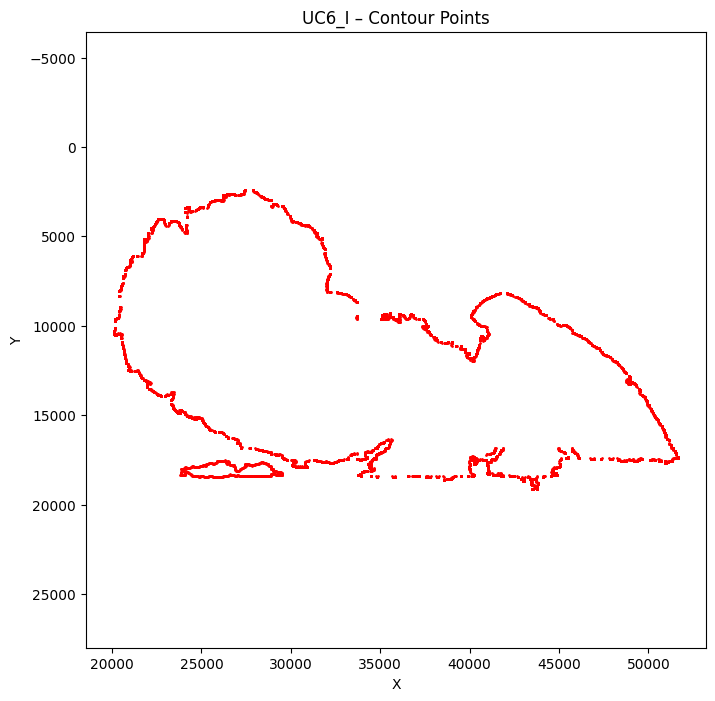

In [19]:
import json
import matplotlib.pyplot as plt
from pathlib import Path

def plot_geojson_points(sample_dir: Path):
    """
    Plot all points from a tissue contour GeoJSON file as a scatter plot.

    Args:
        sample_dir (Path): Path to sample folder containing *_contours.geojson.
    """
    sample_dir = Path(sample_dir)
    contour_path = sample_dir / "tissue_seg" / f"{sample_dir.name}_contours.geojson"

    # load contours
    with open(contour_path) as f:
        geo = json.load(f)

    xs, ys = [], []
    for feature in geo["features"]:
        coords = feature["geometry"]["coordinates"]
        for poly in coords:
            xs.extend([p[0] for p in poly])
            ys.extend([p[1] for p in poly])

    # plot points
    plt.figure(figsize=(8, 8))
    plt.scatter(xs, ys, s=1, color="red")
    plt.gca().invert_yaxis()  # match image coordinates (origin top-left)
    plt.title(f"{sample_dir.name} – Contour Points", fontsize=12)
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.axis("equal")
    plt.show()

plot_geojson_points("/project/simmons_hts/kxu/hest/xenium_data/broad/UC6_I")

In [7]:
st = load_hest_sample("/project/simmons_hts/kxu/hest/xenium_data/broad/UC6_I") 

        'pixel_size' is 0.2125
        'wsi' is <width=54010, height=57868, backend=CuImageWSI>
        'shapes': []


In [5]:
def debug_segment_tissue_deep(st, **kwargs):
    """
    Debug wrapper for st.segment_tissue(method='deep') to check why
    some tissue contours may be missing (e.g., only top 1/3).
    
    Args:
        st: HESTData object
        **kwargs: arguments to pass to st.segment_tissue
    """
    import numpy as np

    # store original function
    original_func = st.segment_tissue

    # patch the function temporarily
    def patched_segment_tissue(*args, **kw):
        print("[DEBUG] Starting deep tissue segmentation...")

        # Call the original deep segmentation function directly
        check_method = kw.get("method", "deep")
        if check_method != "deep":
            raise ValueError("debug_segment_tissue_deep only works with method='deep'")

        # Access WSI dimensions
        width, height = st.wsi.get_dimensions()
        print(f"[DEBUG] WSI dimensions: width={width}, height={height}")

        # Compute patches (from hestcore code)
        fast_mode = True
        patch_size_um = kw.get("patch_size_um", 512)
        target_pxl_size = kw.get("target_pxl_size", 1)
        px_per_patch = patch_size_um / target_pxl_size

        y_starts = np.arange(0, height, px_per_patch)
        x_starts = np.arange(0, width, px_per_patch)

        print(f"[DEBUG] Number of patches in X: {len(x_starts)}, Y: {len(y_starts)}")
#         print(f"[DEBUG] Patch coordinates (x_start, y_start, x_end, y_end):")
#         for y in y_starts:
#             for x in x_starts:
#                 x_end = min(x + px_per_patch, width)
#                 y_end = min(y + px_per_patch, height)
#                 print(f"  ({x:.0f}, {y:.0f}, {x_end:.0f}, {y_end:.0f})")

        # Call the real deep segmentation function
        original_func(**kw)

        # Check the resulting tissue contours bounds
        if st._tissue_contours is not None:
            minx, miny, maxx, maxy = st._tissue_contours.total_bounds
            print(f"[DEBUG] Tissue contours bounds: minx={minx}, miny={miny}, maxx={maxx}, maxy={maxy}")
            print(f"[DEBUG] Fraction of height covered: {(maxy - miny) / height:.2f}")
        else:
            print("[DEBUG] No tissue contours generated!")
            

    # Call the patched function
    patched_segment_tissue()


In [6]:
def debug_segment_tissue_otsu(st, **kwargs):
    """
    Debug wrapper for st.segment_tissue(method='deep') to check why
    some tissue contours may be missing (e.g., only top 1/3).
    
    Args:
        st: HESTData object
        **kwargs: arguments to pass to st.segment_tissue
    """
    import numpy as np

    # store original function
    original_func = st.segment_tissue

    # patch the function temporarily
    def patched_segment_tissue(*args, **kw):
        print("[DEBUG] Starting deep tissue segmentation...")

        # Call the original deep segmentation function directly
        check_method = kw.get("method", "otsu")

        # Access WSI dimensions
        width, height = st.wsi.get_dimensions()
        print(f"[DEBUG] WSI dimensions: width={width}, height={height}")

        # Compute patches (from hestcore code)
        fast_mode = True
        patch_size_um = kw.get("patch_size_um", 512)
        target_pxl_size = kw.get("target_pxl_size", 1)
        px_per_patch = patch_size_um / target_pxl_size

        y_starts = np.arange(0, height, px_per_patch)
        x_starts = np.arange(0, width, px_per_patch)

        print(f"[DEBUG] Number of patches in X: {len(x_starts)}, Y: {len(y_starts)}")
#         print(f"[DEBUG] Patch coordinates (x_start, y_start, x_end, y_end):")
#         for y in y_starts:
#             for x in x_starts:
#                 x_end = min(x + px_per_patch, width)
#                 y_end = min(y + px_per_patch, height)
#                 print(f"  ({x:.0f}, {y:.0f}, {x_end:.0f}, {y_end:.0f})")

        # Call the real deep segmentation function
        original_func(**kw)

        # Check the resulting tissue contours bounds
        if st._tissue_contours is not None:
            minx, miny, maxx, maxy = st._tissue_contours.total_bounds
            print(f"[DEBUG] Tissue contours bounds: minx={minx}, miny={miny}, maxx={maxx}, maxy={maxy}")
            print(f"[DEBUG] Fraction of height covered: {(maxy - miny) / height:.2f}")
        else:
            print("[DEBUG] No tissue contours generated!")
            

    # Call the patched function
    patched_segment_tissue()


In [7]:
st = load_hest_sample("/project/simmons_hts/kxu/hest/xenium_data/broad/UC6_I") 
debug_segment_tissue_deep(st)

/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.2125
        'wsi' is <width=54010, height=57868, backend=CuImageWSI>
        'shapes': []
[DEBUG] Starting deep tissue segmentation...
[DEBUG] WSI dimensions: width=54010, height=57868
[DEBUG] Number of patches in X: 106, Y: 114


100%|██████████| 72/72 [00:04<00:00, 15.04it/s]


[DEBUG] Tissue contours bounds: minx=20114.9, miny=2408.9, maxx=51642.1, maxy=19151.1
[DEBUG] Fraction of height covered: 0.29


In [10]:
import numpy as np
patcher = st.wsi.create_patcher(patch_size=512, src_pixel_size=1)
print("Cols x Rows from patcher:", patcher.get_cols_rows())
print("WSI size:", st.wsi.get_dimensions())

coords_list = []
for patch, x, y in patcher:
    coords_list.append([x, y])

coords_array = np.array(coords_list)
print("Patch coordinates min/max:", np.min(coords_array, axis=0), np.max(coords_array, axis=0))

Cols x Rows from patcher: (106, 114)
WSI size: (54010, 57868)
Patch coordinates min/max: [0 0] [53760 57856]


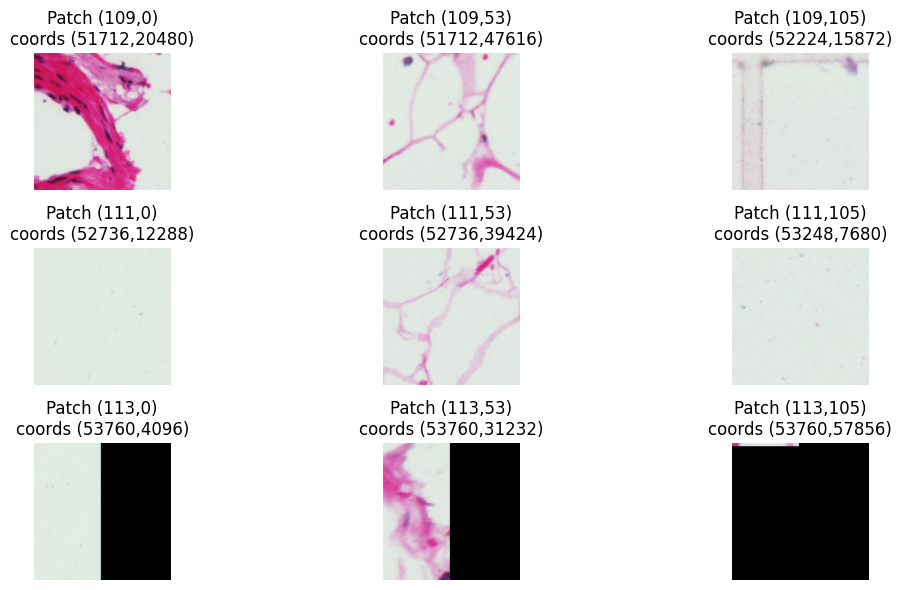

In [11]:
import matplotlib.pyplot as plt

# Assume `patcher` is your CuImageWSIPatcher / WSIPatcher object
cols, rows = patcher.get_cols_rows()

# Pick a few rows near the bottom
sample_rows = [rows-5, rows-3, rows-1]  # last 5th, 3rd, and last row
sample_cols = [0, cols//2, cols-1]      # first, middle, last columns

plt.figure(figsize=(12, 6))
plot_idx = 1

for r in sample_rows:
    for c in sample_cols:
        tile, x, y = patcher[r * cols + c]  # convert 2D to linear index
        plt.subplot(len(sample_rows), len(sample_cols), plot_idx)
        plt.imshow(tile)
        plt.title(f"Patch ({r},{c})\ncoords ({x},{y})")
        plt.axis('off')
        plot_idx += 1

plt.tight_layout()
plt.show()

In [ ]:
# Parameters
cols, rows = patcher.get_cols_rows()
bottom_rows = range(rows-30, rows-20)  # last 10 rows
sample_cols = range(0, cols, max(1, cols // 10))  # 10 columns across

# Figure grid size
fig, axes = plt.subplots(len(bottom_rows), len(sample_cols), figsize=(20, 12))

for i, r in enumerate(bottom_rows):
    for j, c in enumerate(sample_cols):
        tile, x, y = patcher[r * cols + c]  # linear index
        axes[i, j].imshow(tile)
        axes[i, j].axis('off')
        axes[i, j].set_title(f"({x},{y})", fontsize=6)

plt.tight_layout()
plt.show()

In [52]:
# Get the patcher from your HESTData object
patcher = st.wsi.create_patcher(patch_size=512, src_pixel_size=st.pixel_size)

coords = []
for i in range(len(patcher)):
    _, x, y = patcher[i]  # tile is not needed for now
    coords.append((x, y))
coords = np.array(coords)
print(f"Total patches: {len(coords)}")
print(f"Y-coordinates range: {coords[:,1].min()} - {coords[:,1].max()}")

Total patches: 12084
Y-coordinates range: 0 - 57856


In [58]:
src_to_deeplab_scale

0.21253632212536322

In [60]:
# Use the same scale factor from the deep segmentation function
patch_size_src = round(512 / (st.pixel_size / 1))  # example, adjust as needed
src_to_deeplab_scale = 512 / patch_size_src

scaled_coords = coords.copy()
scaled_coords[:,0] = coords[:,0] * src_to_deeplab_scale
scaled_coords[:,1] = coords[:,1] * src_to_deeplab_scale

print(f"Scaled Y-coordinates: min={scaled_coords[:,1].min()}, max={scaled_coords[:,1].max()}")
print(f"Scaled X-coordinates: min={scaled_coords[:,0].min()}, max={scaled_coords[:,0].max()}")

Scaled Y-coordinates: min=0, max=12296
Scaled X-coordinates: min=0, max=11425


In [63]:
cols, rows = patcher.get_cols_rows()
width, height = 512 * cols, 512 * rows
stitched_img = np.zeros((height, width), dtype=np.uint8)
stitched_img.shape

(58368, 54272)

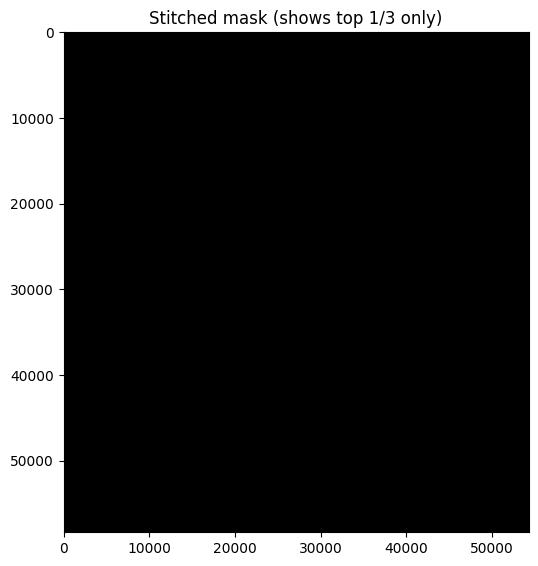

In [64]:
plt.figure(figsize=(6,12))
plt.imshow(stitched_img, cmap='gray')
plt.title("Stitched mask (shows top 1/3 only)")
plt.show()



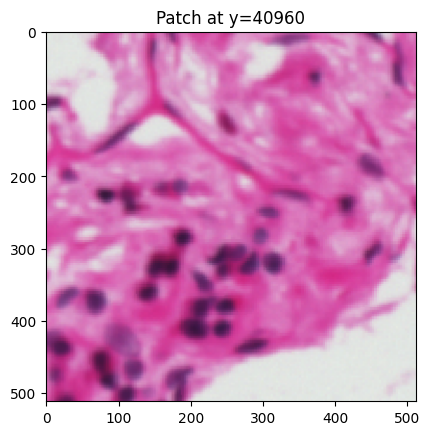

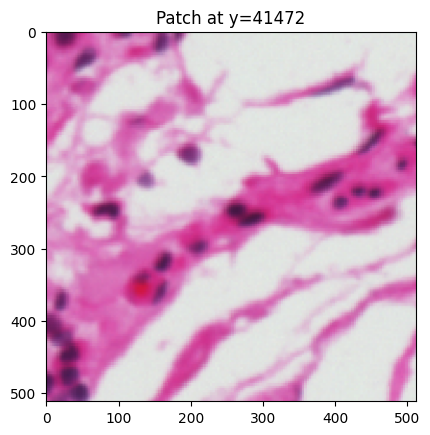

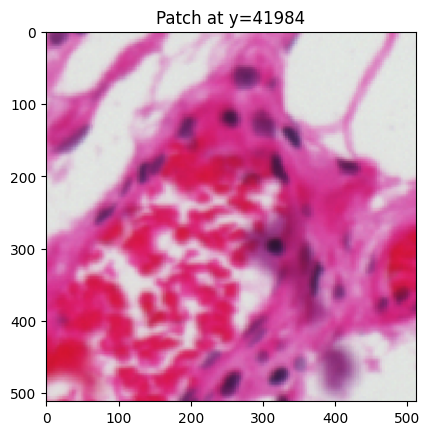

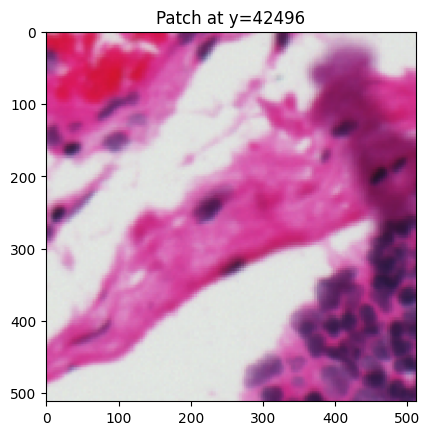

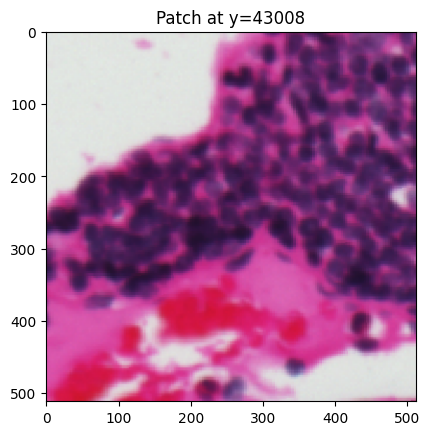

In [59]:
bottom_idx = coords[:,1] > st.wsi.get_dimensions()[1] * 0.7
for i in np.where(bottom_idx)[0][:5]:  # show first 5 bottom patches
    patch, x, y = patcher[i]
    plt.imshow(patch)
    plt.title(f"Patch at y={y}")
    plt.show()

54010
57868
0.03456141563558443
Thumbnail height: 2000 px
Thumbnail width: 1867 px


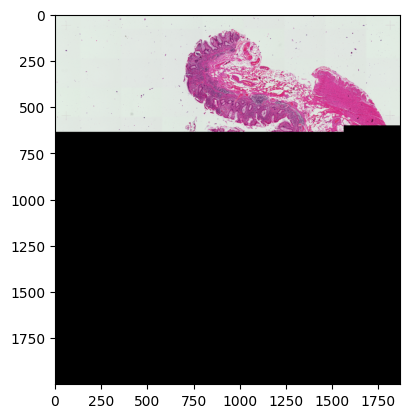

In [13]:
# thumbnail scaling
width, height = st.wsi.get_dimensions()
print(width)
print(height)
scale = 2000 / height
print(scale)
thumb_height = round(height * scale)
print(f"Thumbnail height: {thumb_height} px")
thumb_width = round(width * scale)
print(f"Thumbnail width: {thumb_width} px")

thumb = st.wsi.get_thumbnail(thumb_width, thumb_height)
plt.imshow(thumb)
plt.show()

In [ ]:
full_width, full_height = st.wsi.get_dimensions()
# create thumbnail preserving full height
thumb = st.wsi.get_thumbnail(full_width // 300, full_height // 300)  # adjust downscale factor
plt.imshow(thumb)
plt.show()

2142
13502
14467


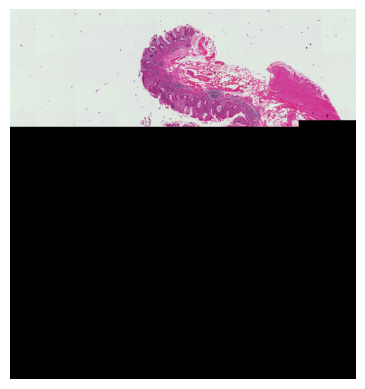

In [15]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import cv2

# Example: generate a thumbnail that includes full height
full_width, full_height = st.wsi.get_dimensions()
thumb_width = 2000
thumb_height = int(full_height * thumb_width / full_width)
print(thumb_height)

# Read multiple strips at the pyramid level
downsample = st.wsi.width / thumb_width
levels = st.wsi.img.resolutions['level_downsamples']
closest = max([i for i, d in enumerate(levels) if d <= downsample])
curr_width, curr_height = st.wsi.img.resolutions['level_dimensions'][closest]
print(curr_width)
print(curr_height)

# read top and bottom strips
top = np.array(st.wsi.img.read_region((0, 0), level=closest, size=(curr_width, curr_height)))
# optionally read bottom region if available
bottom_offset = max(0, curr_height - top.shape[0])
# concatenate if necessary

thumbnail = cv2.resize(top, (thumb_width, thumb_height))
plt.imshow(thumbnail)
plt.axis('off')
plt.show()


In [30]:
import matplotlib.pyplot as plt

def debug_thumbnail(cu_wsi):
    full_w, full_h = cu_wsi.get_dimensions()
    print(f"[INFO] Full resolution: {full_w} x {full_h}")

    # Current thumbnail method (from CuImageWSI)
    thumb = cu_wsi.get_thumbnail(full_w // 30, full_h // 30)
    print(f"[INFO] get_thumbnail() size: {thumb.shape}")

    # Alternative thumbnail: force read_region at level 0 then downsample
    region = cu_wsi.read_region((0, 0), 0, (full_w, full_h))
    alt_thumb = cv2.resize(region, (full_w // 30, full_h // 30))
    print(f"[INFO] manual full read -> resize size: {alt_thumb.shape}")

    # Side-by-side visualization
    fig, axes = plt.subplots(1, 2, figsize=(15, 8))
    axes[0].imshow(thumb)
    axes[0].set_title("CuImageWSI.get_thumbnail()")
    axes[1].imshow(alt_thumb)
    axes[1].set_title("Manual full read -> resize")
    plt.show()


In [31]:
debug_thumbnail(st.wsi)

[INFO] Full resolution: 54010 x 57868
[INFO] get_thumbnail() size: (1928, 1800, 3)
[INFO] manual full read -> resize size: (1928, 1800, 3)


In [29]:
def get_thumbnail(self, width: int, height: int) -> np.ndarray:
    downsample = self.width / width
    downsamples = self.img.resolutions['level_downsamples']
    closest = 0
    for i in range(len(downsamples)):
        if downsamples[i] > downsample:
            break
        closest = i
    
    curr_width, curr_height = self.img.resolutions['level_dimensions'][closest]

    print(f"[DEBUG] get_thumbnail()")
    print(f"  Requested size: {width}x{height}")
    print(f"  Slide full size: {self.width}x{self.height}")
    print(f"  Requested downsample: {downsample:.2f}")
    print(f"  Pyramid downsamples: {downsamples}")
    print(f"  Chosen level: {closest} (downsample={downsamples[closest]})")
    print(f"  Expected level dims: {curr_width}x{curr_height}")

    thumbnail = np.array(
        self.img.read_region(location=(0, 0), level=closest, size=(curr_width, curr_height))
    )
    print(f"  Returned region shape: {thumbnail.shape}")

    thumbnail = cv2.resize(thumbnail, (width, height))
    print(f"  Final resized thumbnail: {thumbnail.shape}")

    # Optional: check if bottom is black
    bottom_mean = thumbnail[-10:, :, :].mean()
    print(f"  Mean pixel value of bottom 10 rows: {bottom_mean:.2f}")

    return thumbnail


[DEBUG] get_thumbnail()
  Requested size: 1000x1000
  Slide full size: 54010x57868
  Requested downsample: 54.01
  Pyramid downsamples: (1.0, 2.0, 4.00007438659668)
  Chosen level: 1 (downsample=4.00007438659668)
  Expected level dims: 13502x14467
  Returned region shape: (14467, 13502, 3)
  Final resized thumbnail: (1000, 1000, 3)
  Mean pixel value of bottom 10 rows: 0.00


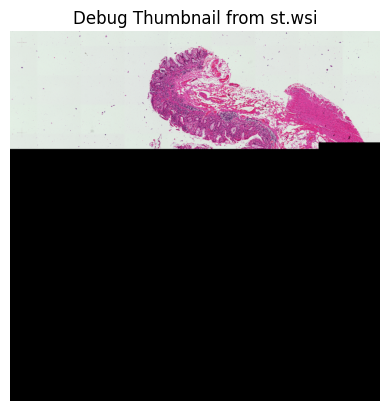

In [9]:
import types
import numpy as np
import cv2

def debug_get_thumbnail(self, width: int, height: int) -> np.ndarray:
    downsample = self.width / width
    downsamples = self.img.resolutions['level_downsamples']
    closest = 0
    for i in range(len(downsamples)):
        if downsamples[i] > downsample:
            break
        closest = i
    
    curr_width, curr_height = self.img.resolutions['level_dimensions'][closest]

    print(f"[DEBUG] get_thumbnail()")
    print(f"  Requested size: {width}x{height}")
    print(f"  Slide full size: {self.width}x{self.height}")
    print(f"  Requested downsample: {downsample:.2f}")
    print(f"  Pyramid downsamples: {downsamples}")
    print(f"  Chosen level: {closest-1} (downsample={downsamples[closest]})")
    print(f"  Expected level dims: {curr_width}x{curr_height}")

    thumbnail = np.array(
        self.img.read_region(location=(0, 0), level=closest, size=(curr_width, curr_height))
    )
    print(f"  Returned region shape: {thumbnail.shape}")

    thumbnail = cv2.resize(thumbnail, (width, height))
    print(f"  Final resized thumbnail: {thumbnail.shape}")

    bottom_mean = thumbnail[-10:, :, :].mean()
    print(f"  Mean pixel value of bottom 10 rows: {bottom_mean:.2f}")

    return thumbnail

# Bind your debug version to the existing object
st.wsi.get_thumbnail = types.MethodType(debug_get_thumbnail, st.wsi)


thumb = st.wsi.get_thumbnail(1000, 1000)

import matplotlib.pyplot as plt
plt.imshow(thumb)
plt.title("Debug Thumbnail from st.wsi")
plt.axis("off")
plt.show()

In [15]:
from types import MethodType
import numpy as np
import cv2
from hestcore.wsi import CuImageWSI, WSI  # adjust path to your project

# --- Safe get_thumbnail for CuImageWSI ---
def safe_get_thumbnail(self, width: int = None, height: int = None) -> np.ndarray:
    """
    Safer thumbnail generation for CuImageWSI.
    Detects incomplete bottom regions and reconstructs from level 0 if necessary.
    """
    if width is None and height is None:
        raise ValueError("At least one of width or height must be specified")

    aspect_ratio = self.width / self.height
    if width is None:
        width = int(height * aspect_ratio)
    elif height is None:
        height = int(width / aspect_ratio)

    downsample = self.width / width
    downsamples = self.img.resolutions['level_downsamples']

    # Pick closest pyramid level
    closest = 0
    for i in range(len(downsamples)):
        if downsamples[i] > downsample:
            break
        closest = i

    curr_width, curr_height = self.img.resolutions['level_dimensions'][closest]
    thumbnail = np.array(
        self.img.read_region(location=(0, 0), level=closest, size=(curr_width, curr_height))
    )
    thumbnail = cv2.resize(thumbnail, (width, height))

    # Detect incomplete thumbnail (black bottom)
    if thumbnail[-min(20, height):].mean() < 1:
        print("[WARN] Incomplete thumbnail detected, reconstructing from level 0...")
        step_x = max(1, self.width // width)
        step_y = max(1, self.height // height)
        sampled = np.zeros((height, width, 3), dtype=np.uint8)

        for yi in range(height):
            y0 = yi * step_y
            row = self.img.read_region(location=(0, y0), level=0, size=(self.width, 1))
            row = np.array(row)
            row = cv2.resize(row, (width, 1))
            sampled[yi, :, :] = row

        thumbnail = sampled

    return thumbnail

# --- Monkey-patch CuImageWSI ---
CuImageWSI.get_thumbnail = safe_get_thumbnail

# segment XeniumPR1segger

In [13]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1')

[INFO] Auto-detected 8 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1: ['ROI8', 'ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']
        'pixel_size' is 0.4370543529121492
        'wsi' is <width=22816, height=13369, backend=CuImageWSI>
        'shapes': []


Using cache found in /home/k/kxu/.cache/torch/hub/pytorch_vision_v0.10.0


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 30/30 [00:03<00:00,  9.66it/s]


[INFO] Segmentation complete for ROI8 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI8/tissue_seg
        'pixel_size' is 0.43509460497596525
        'wsi' is <width=14343, height=8724, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00,  9.58it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI4/tissue_seg
        'pixel_size' is 0.4353514884015406
        'wsi' is <width=8851, height=8585, backend=CuImageWSI>
        'shapes': []


100%|██████████| 8/8 [00:01<00:00,  7.93it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI1/tissue_seg
        'pixel_size' is 0.43561023341205224
        'wsi' is <width=7408, height=10434, backend=CuImageWSI>
        'shapes': []


100%|██████████| 8/8 [00:00<00:00,  8.54it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI2/tissue_seg
        'pixel_size' is 0.4342285450650283
        'wsi' is <width=29752, height=7302, backend=CuImageWSI>
        'shapes': []


100%|██████████| 23/23 [00:01<00:00, 14.90it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI5/tissue_seg
        'pixel_size' is 0.434453340495722
        'wsi' is <width=25467, height=11081, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:02<00:00, 13.44it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI6/tissue_seg
        'pixel_size' is 0.4338127352315242
        'wsi' is <width=22924, height=12938, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:01<00:00, 14.44it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI7/tissue_seg
        'pixel_size' is 0.4346822863887948
        'wsi' is <width=12994, height=8725, backend=CuImageWSI>
        'shapes': []


100%|██████████| 12/12 [00:01<00:00,  8.70it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI3/tissue_seg


In [14]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2')

[INFO] Auto-detected 8 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2: ['ROI4', 'ROI1', 'ROI2', 'ROI5', 'tissue_seg', 'ROI6', 'ROI7', 'ROI3']


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.43512933641298734
        'wsi' is <width=19736, height=16011, backend=CuImageWSI>
        'shapes': []


100%|██████████| 30/30 [00:02<00:00, 14.50it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI4/tissue_seg
        'pixel_size' is 0.43483325563202857
        'wsi' is <width=17305, height=16539, backend=CuImageWSI>
        'shapes': []


100%|██████████| 29/29 [00:02<00:00, 12.17it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI1/tissue_seg
        'pixel_size' is 0.4344276223626176
        'wsi' is <width=22676, height=11873, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:01<00:00, 15.16it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI2/tissue_seg
        'pixel_size' is 0.4346128823579932
        'wsi' is <width=10488, height=12013, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00, 10.92it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI5/tissue_seg
[ERROR] Failed segmentation for tissue_seg: Missing /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/tissue_seg/aligned_adata.h5ad
        'pixel_size' is 0.4357339146174697
        'wsi' is <width=11505, height=16363, backend=CuImageWSI>
        'shapes': []


100%|██████████| 18/18 [00:01<00:00, 12.85it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI6/tissue_seg
        'pixel_size' is 0.43486571487000075
        'wsi' is <width=17044, height=10800, backend=CuImageWSI>
        'shapes': []


100%|██████████| 19/19 [00:01<00:00, 12.81it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI7/tissue_seg
        'pixel_size' is 0.43424436873240163
        'wsi' is <width=15550, height=12731, backend=CuImageWSI>
        'shapes': []


100%|██████████| 20/20 [00:01<00:00, 13.34it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI3/tissue_seg


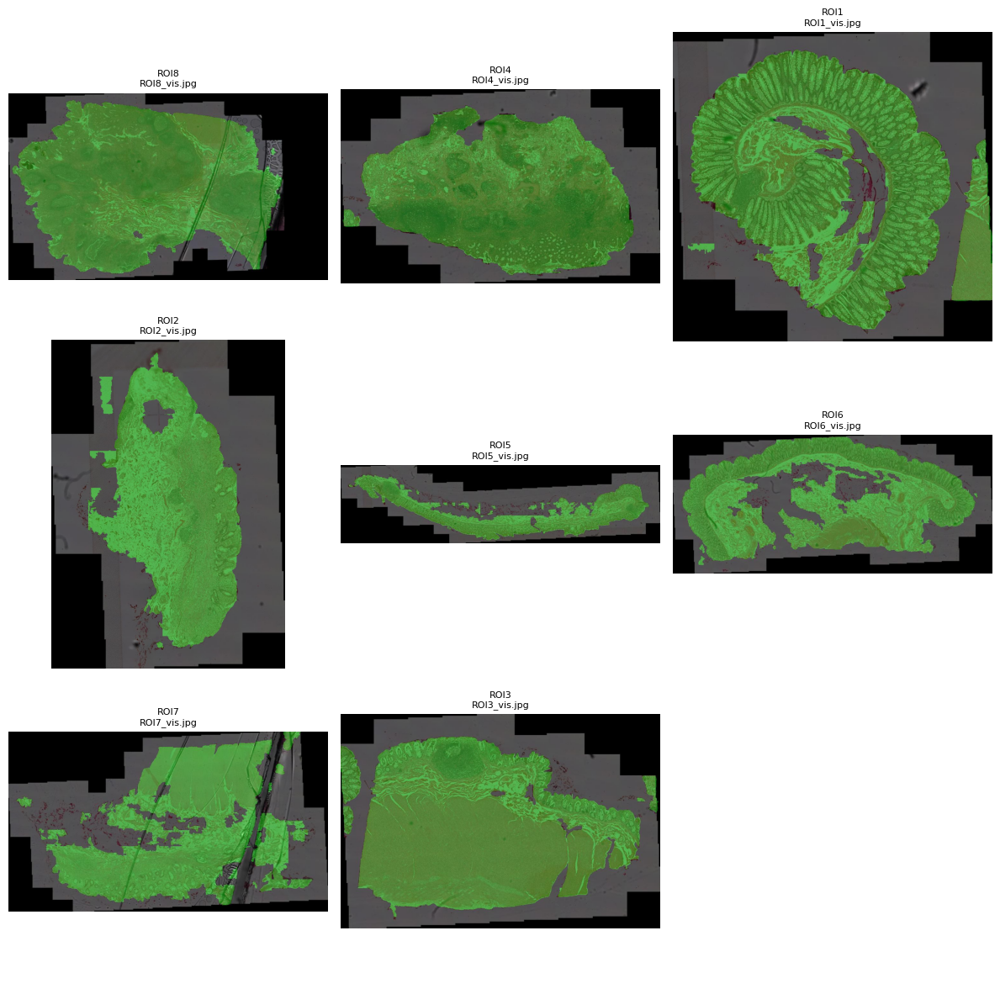

In [4]:
import math
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt

def show_images(
    broad_dir: Path,
    ids=None,
    subfolders=("tissue_seg",),   # one or many subfolders under each sample
    recursive=True,               # search recursively inside each subfolder
    max_cols=3,
    figsize=(4, 4),               # size of each grid cell (in inches)
    max_images=None,              # optional global cap on total images
    max_images_per_sample=None,   # optional cap per sample
    max_display_px=1024,          # max width/height for displayed images
):
    """
    Display image files from flexible subfolders under each sample directory,
    with automatic downsampling to ensure grid display fits nicely.

    Args:
        broad_dir (Path): path to xenium_data/broad directory (contains sample folders)
        ids (list[str], optional): specific sample folder names; if None, auto-detect all
        subfolders (tuple[str]): subfolder names under each sample
        recursive (bool): recurse within each subfolder
        max_cols (int): max columns in the grid
        figsize (tuple): (width, height) in inches for each subplot
        max_images (int|None): cap total number of images displayed
        max_images_per_sample (int|None): cap images per sample
        max_display_px (int): maximum width/height in pixels for display
    """
    broad_dir = Path(broad_dir)
    valid_exts = {".jpg", ".jpeg", ".png", ".tif", ".tiff", ".bmp", ".gif"}

    # auto-detect sample folders if not provided
    if ids is None:
        ids = [p.name for p in broad_dir.iterdir() if p.is_dir()]
    if not ids:
        raise ValueError(f"No sample folders found in {broad_dir}")

    images, labels = [], []

    for sample_id in ids:
        sample_dir = broad_dir / sample_id
        if not sample_dir.is_dir():
            continue

        found_for_sample = []
        for sub in subfolders:
            sub_path = sample_dir / sub
            if not sub_path.exists():
                continue
            search_iter = sub_path.rglob("*") if recursive else sub_path.glob("*")
            for f in search_iter:
                if f.is_file() and f.suffix.lower() in valid_exts:
                    found_for_sample.append(f)

        found_for_sample = sorted(set(found_for_sample))
        if max_images_per_sample is not None:
            found_for_sample = found_for_sample[:max_images_per_sample]

        images.extend(found_for_sample)
        labels.extend([sample_id] * len(found_for_sample))

    if not images:
        print("[WARN] No images found across all samples.")
        return

    if max_images is not None:
        images = images[:max_images]
        labels = labels[:len(images)]

    # grid layout
    n_images = len(images)
    n_cols = min(max_cols, n_images)
    n_rows = math.ceil(n_images / n_cols)

    fig, axes = plt.subplots(
        n_rows, n_cols,
        figsize=(figsize[0] * n_cols, figsize[1] * n_rows)
    )
    axes = axes.flatten() if n_images > 1 else [axes]

    for ax, img_path, sample_id in zip(axes, images, labels):
        try:
            img = Image.open(img_path)

            # downsample large images for display only
            w, h = img.size
            scale = min(max_display_px / max(w, h), 1.0)
            if scale < 1.0:
                new_size = (int(w * scale), int(h * scale))
                img = img.resize(new_size, Image.LANCZOS)

            ax.imshow(img)
            ax.axis("off")
            ax.set_title(f"{sample_id}\n{img_path.name}", fontsize=8)
        except Exception as e:
            ax.axis("off")
            ax.set_title(f"Failed: {img_path.name}", fontsize=8)
            print(f"[ERROR] Could not open {img_path}: {e}")

    # hide unused axes
    for ax in axes[len(images):]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1", subfolders=("tissue_seg",))

In [17]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2", subfolders=("tissue_seg",))

# Segment Xenium 50 um patch

In [2]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1')

[INFO] Auto-detected 8 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1: ['ROI8', 'ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']
        'pixel_size' is 0.4370543529121492
        'wsi' is <width=22816, height=13369, backend=CuImageWSI>
        'shapes': []


Using cache found in /home/k/kxu/.cache/torch/hub/pytorch_vision_v0.10.0


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 30/30 [00:03<00:00,  9.48it/s]


[INFO] Segmentation complete for ROI8 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI8/tissue_seg
        'pixel_size' is 0.43509460497596525
        'wsi' is <width=14343, height=8724, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00,  8.71it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI4/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.4353514884015406
        'wsi' is <width=8851, height=8585, backend=CuImageWSI>
        'shapes': []


100%|██████████| 8/8 [00:01<00:00,  6.61it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI1/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.43561023341205224
        'wsi' is <width=7408, height=10434, backend=CuImageWSI>
        'shapes': []


100%|██████████| 8/8 [00:01<00:00,  7.68it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI2/tissue_seg
        'pixel_size' is 0.4342285450650283
        'wsi' is <width=29752, height=7302, backend=CuImageWSI>
        'shapes': []


100%|██████████| 23/23 [00:01<00:00, 13.04it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI5/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.434453340495722
        'wsi' is <width=25467, height=11081, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:01<00:00, 14.38it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI6/tissue_seg
        'pixel_size' is 0.4338127352315242
        'wsi' is <width=22924, height=12938, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:01<00:00, 14.50it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI7/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.4346822863887948
        'wsi' is <width=12994, height=8725, backend=CuImageWSI>
        'shapes': []


100%|██████████| 12/12 [00:01<00:00,  7.95it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI3/tissue_seg


In [3]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2')

[INFO] Auto-detected 7 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2: ['ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.43512933641298734
        'wsi' is <width=19736, height=16011, backend=CuImageWSI>
        'shapes': []


100%|██████████| 30/30 [00:02<00:00, 14.09it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI4/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.43483325563202857
        'wsi' is <width=17305, height=16539, backend=CuImageWSI>
        'shapes': []


100%|██████████| 29/29 [00:02<00:00, 11.36it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI1/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.4344276223626176
        'wsi' is <width=22676, height=11873, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:01<00:00, 14.09it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI2/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.4346128823579932
        'wsi' is <width=10488, height=12013, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00, 10.12it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI5/tissue_seg
        'pixel_size' is 0.4357339146174697
        'wsi' is <width=11505, height=16363, backend=CuImageWSI>
        'shapes': []


100%|██████████| 18/18 [00:01<00:00, 12.33it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI6/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.43486571487000075
        'wsi' is <width=17044, height=10800, backend=CuImageWSI>
        'shapes': []


100%|██████████| 19/19 [00:01<00:00, 11.50it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI7/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.43424436873240163
        'wsi' is <width=15550, height=12731, backend=CuImageWSI>
        'shapes': []


100%|██████████| 20/20 [00:01<00:00, 11.56it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI3/tissue_seg


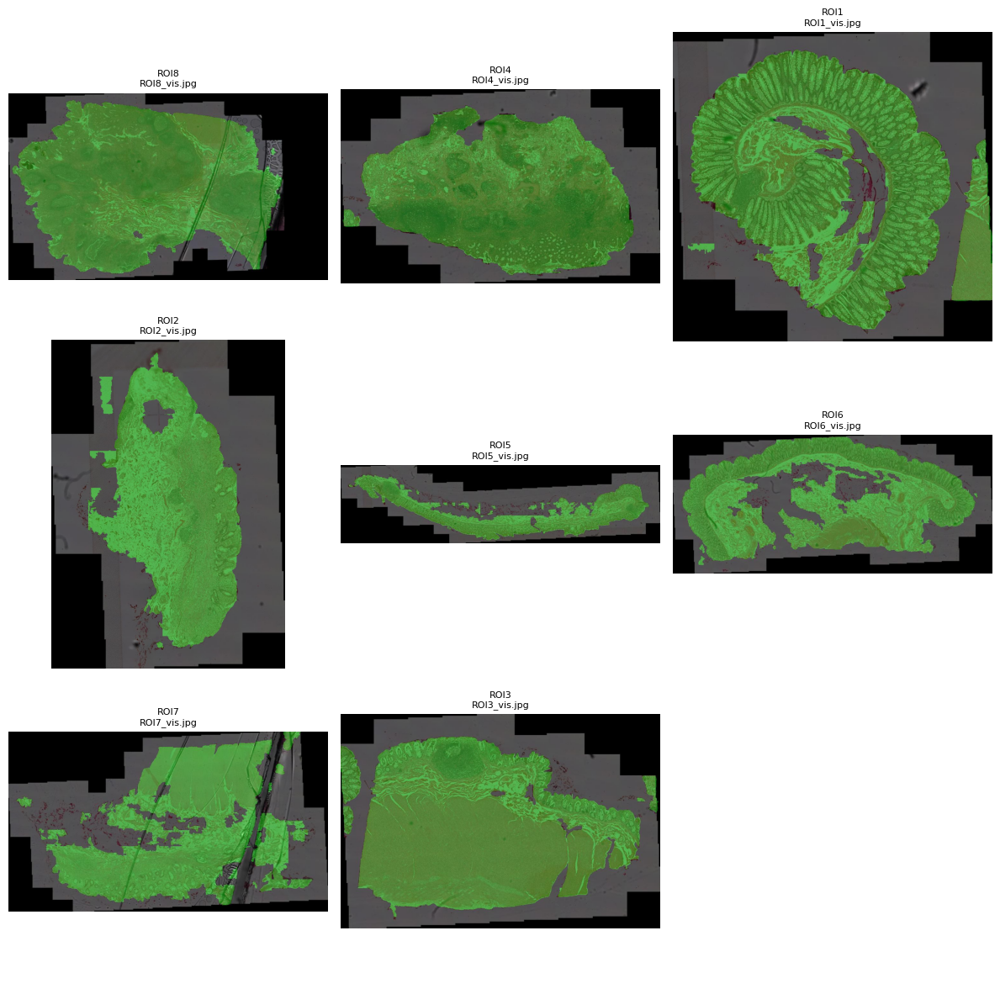

In [4]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1", subfolders=("tissue_seg",))

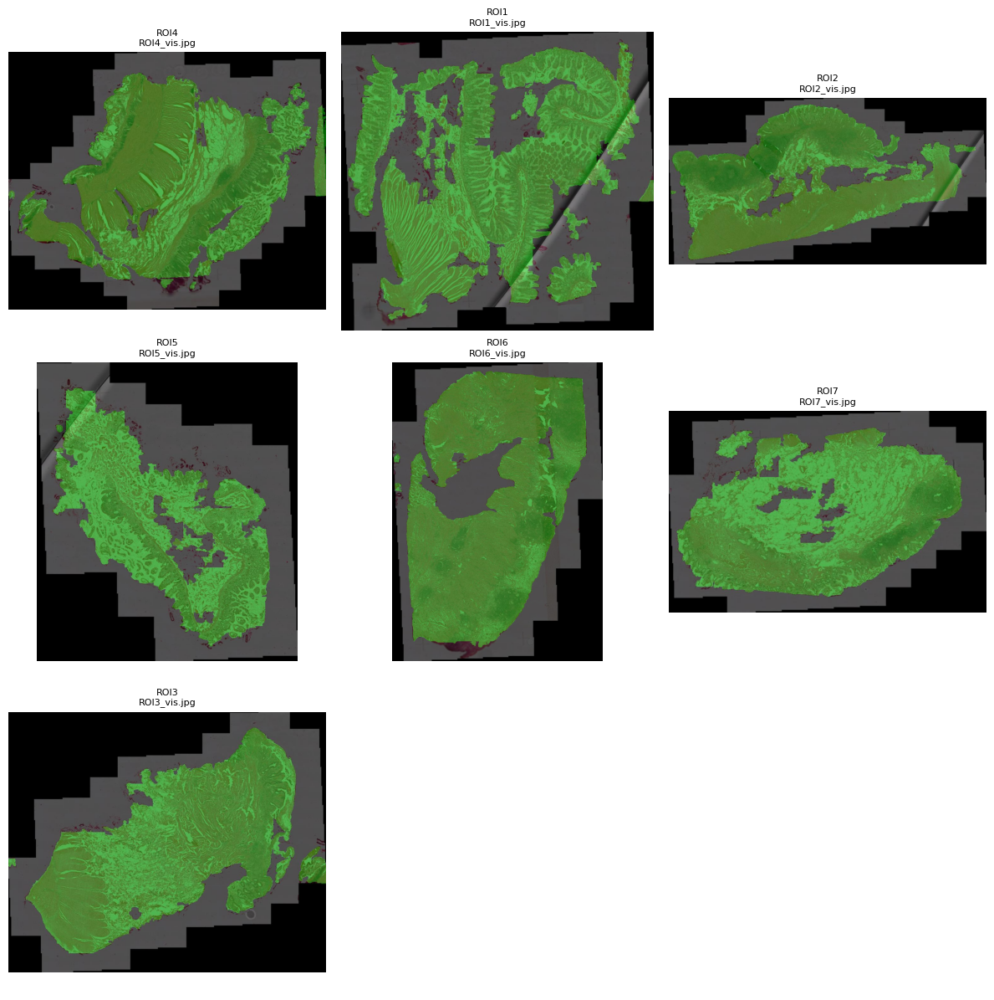

In [6]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2", subfolders=("tissue_seg",))

# Segment XeniumPR1_25um

In [5]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1')

[INFO] Auto-detected 8 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1: ['ROI8', 'ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']
        'pixel_size' is 0.4370543529121492
        'wsi' is <width=22816, height=13369, backend=CuImageWSI>
        'shapes': []


/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
Using cache found in /home/k/kxu/.cache/torch/hub/pytorch_vision_v0.10.0


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 30/30 [00:04<00:00,  6.33it/s]


[INFO] Segmentation complete for ROI8 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI8/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.43509460497596525
        'wsi' is <width=14343, height=8724, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00,  7.13it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI4/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4353514884015406
        'wsi' is <width=8851, height=8585, backend=CuImageWSI>
        'shapes': []


100%|██████████| 8/8 [00:01<00:00,  5.36it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI1/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.43561023341205224
        'wsi' is <width=7408, height=10434, backend=CuImageWSI>
        'shapes': []


100%|██████████| 8/8 [00:01<00:00,  7.51it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI2/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4342285450650283
        'wsi' is <width=29752, height=7302, backend=CuImageWSI>
        'shapes': []


100%|██████████| 23/23 [00:01<00:00, 12.06it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI5/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.434453340495722
        'wsi' is <width=25467, height=11081, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:02<00:00, 13.00it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI6/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4338127352315242
        'wsi' is <width=22924, height=12938, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:02<00:00, 12.08it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI7/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4346822863887948
        'wsi' is <width=12994, height=8725, backend=CuImageWSI>
        'shapes': []


100%|██████████| 12/12 [00:01<00:00,  8.75it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1/ROI3/tissue_seg


In [6]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2')

[INFO] Auto-detected 7 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2: ['ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.43512933641298734
        'wsi' is <width=19736, height=16011, backend=CuImageWSI>
        'shapes': []


100%|██████████| 30/30 [00:01<00:00, 15.03it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI4/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.43483325563202857
        'wsi' is <width=17305, height=16539, backend=CuImageWSI>
        'shapes': []


100%|██████████| 29/29 [00:02<00:00, 10.91it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI1/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4344276223626176
        'wsi' is <width=22676, height=11873, backend=CuImageWSI>
        'shapes': []


100%|██████████| 28/28 [00:02<00:00, 11.76it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI2/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4346128823579932
        'wsi' is <width=10488, height=12013, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00, 11.39it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI5/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.4357339146174697
        'wsi' is <width=11505, height=16363, backend=CuImageWSI>
        'shapes': []


100%|██████████| 18/18 [00:01<00:00, 11.43it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI6/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.43486571487000075
        'wsi' is <width=17044, height=10800, backend=CuImageWSI>
        'shapes': []


100%|██████████| 19/19 [00:01<00:00, 13.31it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI7/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]
/package/python-cbrg/current/3.11.13/lib/python3.11/site-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


        'pixel_size' is 0.43424436873240163
        'wsi' is <width=15550, height=12731, backend=CuImageWSI>
        'shapes': []


100%|██████████| 20/20 [00:01<00:00, 11.71it/s]

[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2/ROI3/tissue_seg


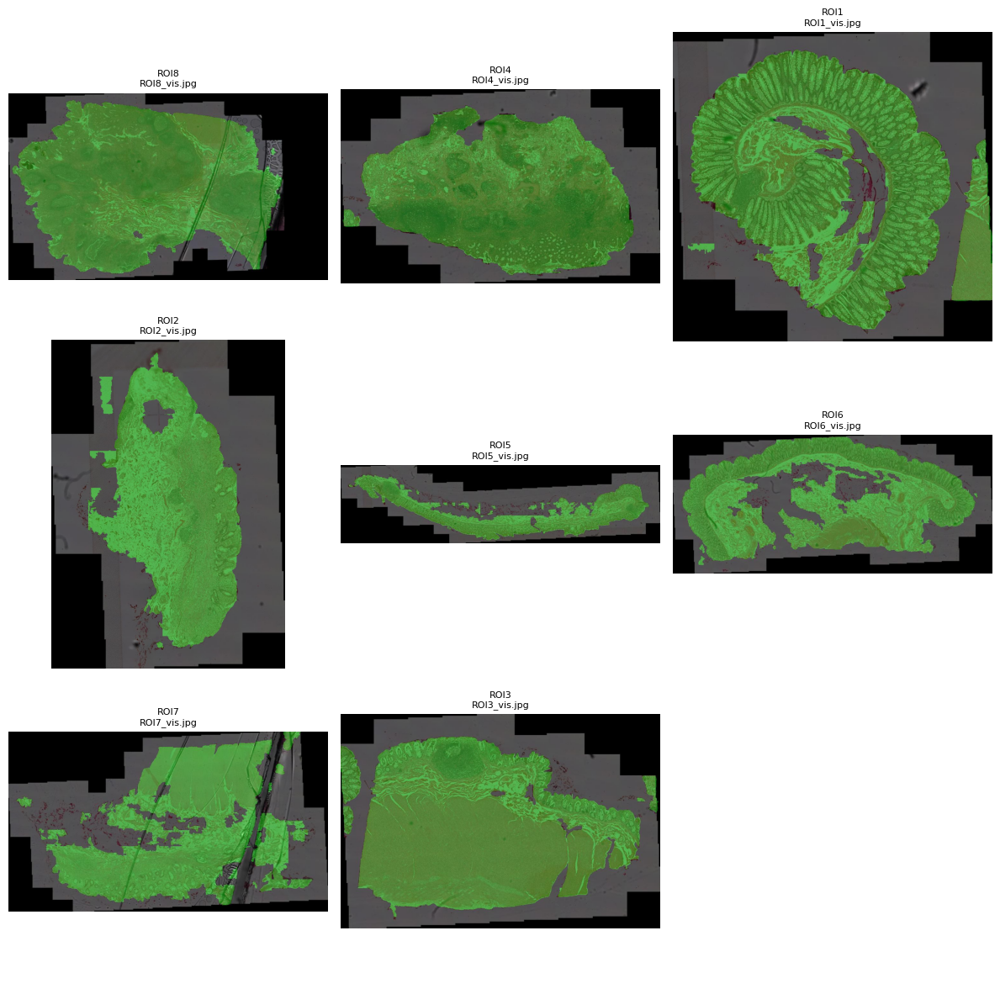

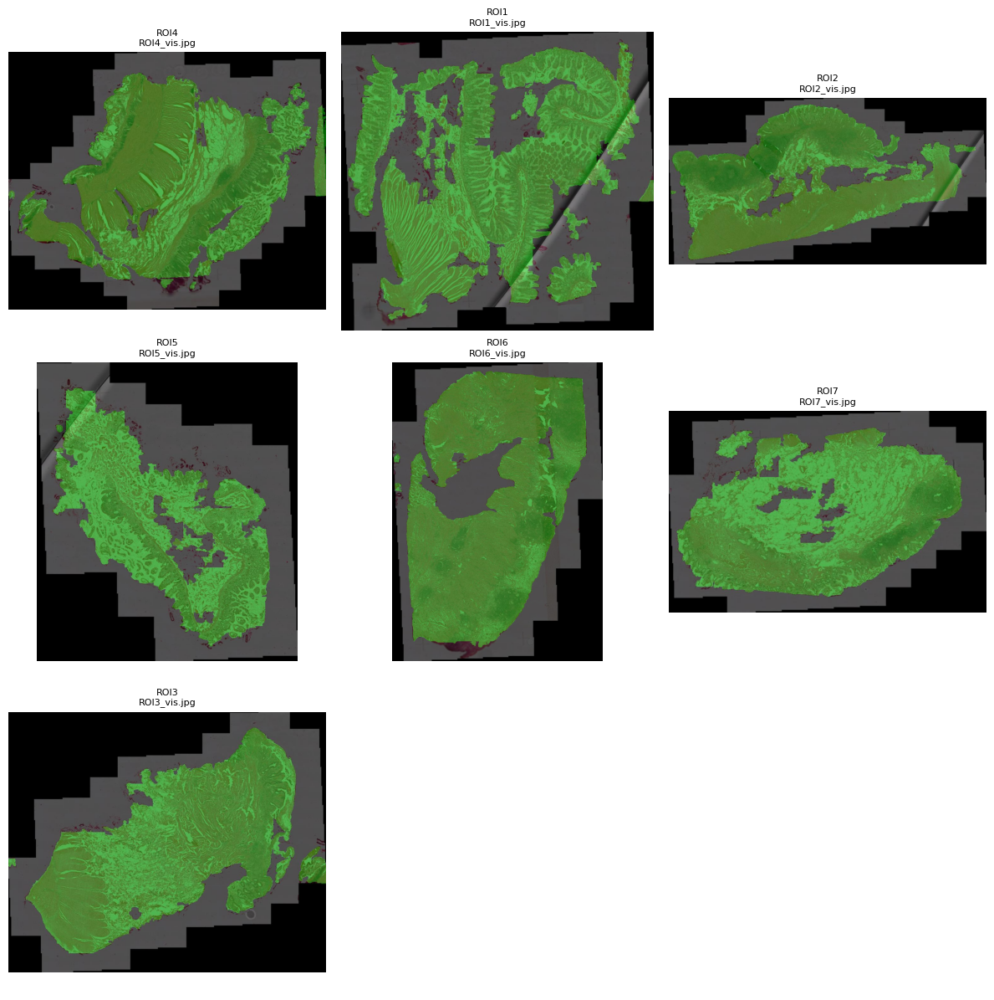

In [7]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide1", subfolders=("tissue_seg",))
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_25um/slide2", subfolders=("tissue_seg",))

# Segment XeniumPR2

In [2]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1')

[INFO] Auto-detected 8 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1: ['ROI8', 'ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']
        'pixel_size' is 0.22047194943862095
        'wsi' is <width=28979, height=37863, backend=CuImageWSI>
        'shapes': []


Using cache found in /home/k/kxu/.cache/torch/hub/pytorch_vision_v0.10.0


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 28/28 [00:03<00:00,  9.15it/s]


[INFO] Segmentation complete for ROI8 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI8/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.22042490374755971
        'wsi' is <width=41880, height=17378, backend=CuImageWSI>
        'shapes': []


100%|██████████| 19/19 [00:01<00:00, 12.85it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI4/tissue_seg
        'pixel_size' is 0.22046996430606813
        'wsi' is <width=36154, height=29248, backend=CuImageWSI>
        'shapes': []


100%|██████████| 26/26 [00:01<00:00, 14.62it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI1/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.22044341145869342
        'wsi' is <width=40436, height=27095, backend=CuImageWSI>
        'shapes': []


100%|██████████| 27/27 [00:01<00:00, 14.78it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI2/tissue_seg
        'pixel_size' is 0.22044738679715123
        'wsi' is <width=39000, height=32472, backend=CuImageWSI>
        'shapes': []


100%|██████████| 30/30 [00:01<00:00, 15.50it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI5/tissue_seg
        'pixel_size' is 0.22049483980597748
        'wsi' is <width=18874, height=17384, backend=CuImageWSI>
        'shapes': []


100%|██████████| 9/9 [00:01<00:00,  8.94it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI6/tissue_seg
        'pixel_size' is 0.22050080354355434
        'wsi' is <width=21763, height=20608, backend=CuImageWSI>
        'shapes': []


100%|██████████| 12/12 [00:01<00:00, 10.25it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI7/tissue_seg


/package/python-cbrg/current/3.11.11/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:426: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


        'pixel_size' is 0.22042490374755971
        'wsi' is <width=41880, height=17378, backend=CuImageWSI>
        'shapes': []


100%|██████████| 19/19 [00:01<00:00, 13.38it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI3/tissue_seg


In [3]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1", subfolders=("tissue_seg",))

# Segment XeniumPR3

In [4]:
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1')

[INFO] Auto-detected 8 samples from /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1: ['ROI8', 'ROI4', 'ROI1', 'ROI2', 'ROI5', 'ROI6', 'ROI7', 'ROI3']
        'pixel_size' is 0.22045634263844796
        'wsi' is <width=28959, height=21700, backend=CuImageWSI>
        'shapes': []


100%|██████████| 17/17 [00:01<00:00, 12.62it/s]


[INFO] Segmentation complete for ROI8 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI8/tissue_seg
        'pixel_size' is 0.22041720307711582
        'wsi' is <width=36130, height=22770, backend=CuImageWSI>
        'shapes': []


100%|██████████| 20/20 [00:01<00:00, 14.13it/s]


[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI4/tissue_seg
        'pixel_size' is 0.22048850953081675
        'wsi' is <width=18919, height=47567, backend=CuImageWSI>
        'shapes': []


100%|██████████| 24/24 [00:01<00:00, 13.98it/s]


[INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI1/tissue_seg
        'pixel_size' is 0.22066720343864732
        'wsi' is <width=15989, height=16316, backend=CuImageWSI>
        'shapes': []


100%|██████████| 7/7 [00:01<00:00,  6.94it/s]


[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI2/tissue_seg
        'pixel_size' is 0.2204176453879182
        'wsi' is <width=26068, height=24940, backend=CuImageWSI>
        'shapes': []


100%|██████████| 17/17 [00:01<00:00, 12.47it/s]


[INFO] Segmentation complete for ROI5 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI5/tissue_seg
        'pixel_size' is 0.2204484764315189
        'wsi' is <width=21779, height=42164, backend=CuImageWSI>
        'shapes': []


100%|██████████| 24/24 [00:01<00:00, 12.60it/s]


[INFO] Segmentation complete for ROI6 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI6/tissue_seg
        'pixel_size' is 0.22043846650257393
        'wsi' is <width=18893, height=23834, backend=CuImageWSI>
        'shapes': []


100%|██████████| 13/13 [00:01<00:00, 10.43it/s]


[INFO] Segmentation complete for ROI7 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI7/tissue_seg
        'pixel_size' is 0.22044554500792804
        'wsi' is <width=24646, height=28173, backend=CuImageWSI>
        'shapes': []


100%|██████████| 18/18 [00:01<00:00, 12.48it/s]


[INFO] Segmentation complete for ROI3 → /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI3/tissue_seg


In [5]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1", subfolders=("tissue_seg",))

# Segment PR4 (Coeliac)

In [2]:
import ipy_slurm_exec
%load_ext ipy_slurm_exec

In [3]:
%%slurm_exec --partition=gpu --gpus=1 --time=00:10:00 --mem=5G --cpus-per-task=10
import dask
import hest
print(hest.__version__)
from hest.HESTData import read_HESTData
from pathlib import Path
import torch

import warnings
import numpy as np
import tifffile as tiff

from hestcore.wsi import NumpyWSI

# cutomised function
from hest.segmentation.segment_wrapper import *

base_dir = Path("/project/simmons_hts/kxu/hest/xenium_data")

for i in range(4, 6):  # XeniumPR4–PR5
    xenium_dir = base_dir / f"XeniumPR{i}"
    if not xenium_dir.exists():
        continue

    for slide_dir in sorted(xenium_dir.glob("slide*")):
        if slide_dir.is_dir():
            print(f"🚀 Running segmentation for: {slide_dir}")
            segment_hest_tissue(str(slide_dir),target_pxl_size = 0.25)

Submitted Slurm job 4505300 (folder: slurm_exec/20251117T1742-2101ef31)
Job completed                                                                   
Imported variables: NumpyWSI, Path, base_dir, i, load_hest_sample, read_HESTData, segment_hest_tissue, show_images, …
Resource efficiency:
    JobID    State       Elapsed  TimeEff   CPUEff   MemEff 
  4505300  COMPLETED    00:07:46   77.7%    31.5%    86.8%


In [5]:
# visualise at target_pxl_size = 0.25
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR4/slide1", subfolders=("tissue_seg",))

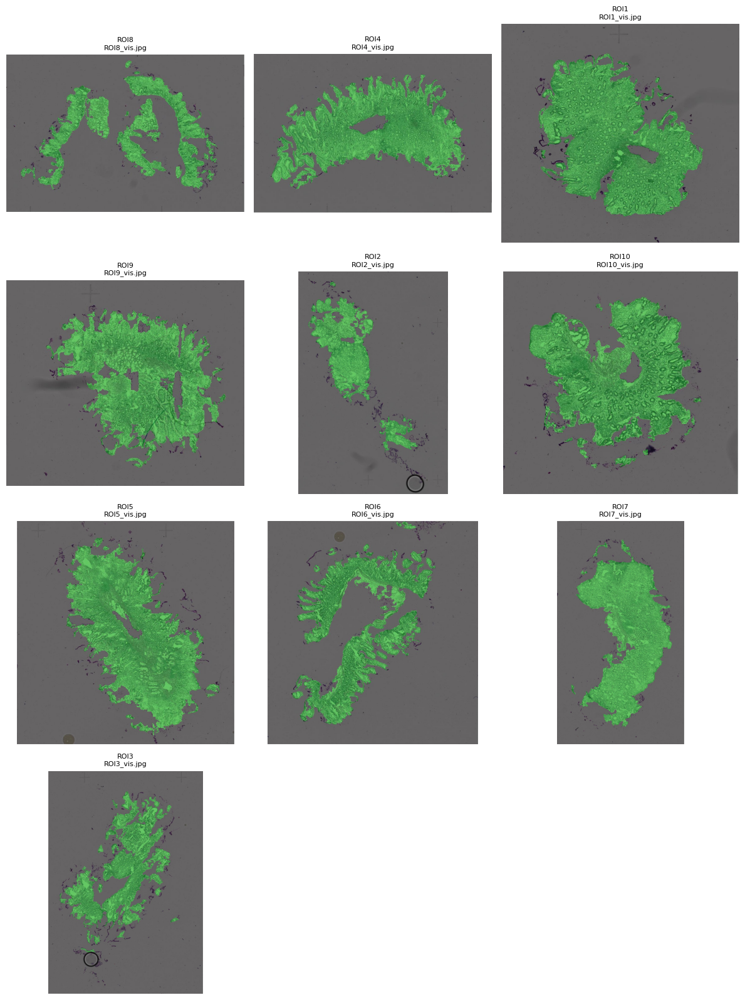

In [ ]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR4/slide2", subfolders=("tissue_seg",))
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR5/slide1", subfolders=("tissue_seg",))

### Segmentation algorithm did not detect lots of regions at the default target_pxl_size (1)

In [6]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR4/slide1", subfolders=("tissue_seg",))

In [7]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR4/slide2", subfolders=("tissue_seg",))

# Segment PR5 (Coeliac)

In [11]:
%%slurm_exec --partition=gpu --gpus=1 --time=00:10:00 --mem=5G --cpus-per-task=10
import dask
import hest
print(hest.__version__)
from hest.HESTData import read_HESTData
from pathlib import Path
import torch

import warnings
import numpy as np
import tifffile as tiff

from hestcore.wsi import NumpyWSI

# cutomised function
from hest.segmentation.segment_wrapper import *

base_dir = Path("/project/simmons_hts/kxu/hest/xenium_data")

for i in range(5, 7):  # XeniumPR4–PR5
    xenium_dir = base_dir / f"XeniumPR{i}"
    if not xenium_dir.exists():
        continue

    for slide_dir in sorted(xenium_dir.glob("slide*")):
        if slide_dir.is_dir():
            print(f"🚀 Running segmentation for: {slide_dir}")
            segment_hest_tissue(str(slide_dir),target_pxl_size = 0.5)

Submitted Slurm job 4566419 (folder: slurm_exec/20251121T1551-c6f1fe19)
Job completed                                                                   
Imported variables: NumpyWSI, Path, base_dir, i, load_hest_sample, read_HESTData, segment_hest_tissue, show_images, …
Resource efficiency:
    JobID    State       Elapsed  TimeEff   CPUEff   MemEff 
  4566419  COMPLETED    00:02:47   27.8%    42.0%    49.8%


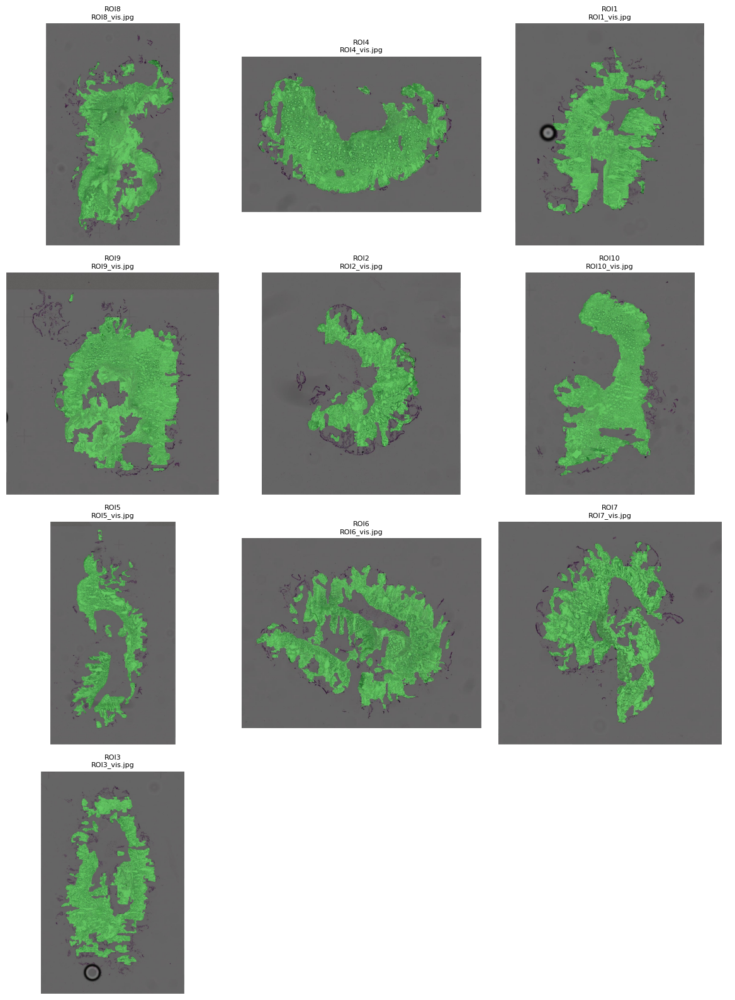

In [12]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR5/slide1", subfolders=("tissue_seg",))

In [16]:
show_images("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR5/slide2", subfolders=("tissue_seg",))

# segment Xenium 480

In [12]:
import ipy_slurm_exec
%load_ext ipy_slurm_exec

The ipy_slurm_exec extension is already loaded. To reload it, use:
  %reload_ext ipy_slurm_exec


In [8]:
%%slurm_exec --partition=gpu --gpus=1 --time=00:10:00
import dask
import hest
print(hest.__version__)
from hest.HESTData import read_HESTData
from pathlib import Path
import torch

import warnings
import numpy as np
import tifffile as tiff

from hestcore.wsi import NumpyWSI

# cutomised function
from hest.segmentation.segment_wrapper import *
segment_hest_tissue('/project/simmons_hts/kxu/hest/xenium_data/XeniumR1/slide1')

Submitted Slurm job 4404805 (folder: slurm_exec/20251031T1451-3b04d419)
Job completed                                                                   
Imported variables: NumpyWSI, Path, load_hest_sample, read_HESTData, segment_hest_tissue, show_images
Resource efficiency:
    JobID    State       Elapsed  TimeEff   CPUEff   MemEff 
  4404805  COMPLETED    00:01:32   15.3%    26.1%    13.2%


In [ ]:
%%slurm_exec --partition=gpu-ada --gpus=1 --time=00:10:00 --mem=5G --cpus-per-task=10
import dask
import hest
print(hest.__version__)
from hest.HESTData import read_HESTData
from pathlib import Path
import torch

import warnings
import numpy as np
import tifffile as tiff

from hestcore.wsi import NumpyWSI

# cutomised function
from hest.segmentation.segment_wrapper import *

base_dir = Path("/project/simmons_hts/kxu/hest/xenium_data")

for i in range(1, 7):  # XeniumR1–R6
    xenium_dir = base_dir / f"XeniumR{i}"
    if not xenium_dir.exists():
        continue

    for slide_dir in sorted(xenium_dir.glob("slide*")):
        if slide_dir.is_dir():
            print(f"🚀 Running segmentation for: {slide_dir}")
            segment_hest_tissue(str(slide_dir))

Submitted Slurm job 4404861 (folder: slurm_exec/20251031T1525-a292353c)
Job 4404861 status: PENDING (checked 15:39:19)                                  

# Segment Visium

In [1]:
import ipy_slurm_exec
%load_ext ipy_slurm_exec

In [2]:
%%slurm_exec --partition=gpu --gpus=1 --time=00:10:00 --mem=5G --cpus-per-task=10
import dask
import hest
print(hest.__version__)
from hest.HESTData import read_HESTData
from pathlib import Path
import torch

import warnings
import numpy as np
import tifffile as tiff

from hestcore.wsi import NumpyWSI

# cutomised function
from hest.segmentation.segment_wrapper import *

base_dir = Path("/project/simmons_hts/kxu/hest/visium_data")

for i in range(1, 7):  # VisiumR1–R6
    xenium_dir = base_dir / f"VisiumR{i}"
    if not xenium_dir.exists():
        continue

    for slide_dir in sorted(xenium_dir.glob("slide*")):
        if slide_dir.is_dir():
            print(f"🚀 Running segmentation for: {slide_dir}")
            segment_hest_tissue(str(slide_dir))

Submitted Slurm job 4613688 (folder: slurm_exec/20251202T1749-b8fcbcbe)
Job 4613688 status: RUNNING (checked 17:49:52)                                  0.0.1
🚀 Running segmentation for: /project/simmons_hts/kxu/hest/visium_data/VisiumR1/slide1
[INFO] Auto-detected 4 samples from /project/simmons_hts/kxu/hest/visium_data/VisiumR1/slide1: ['ROI4', 'ROI1', 'ROI2', 'ROI3']
        'pixel_size' is 0.879899488896232
        'wsi' is <width=9457, height=9234, backend=OpenSlideWSI>
        'shapes': []
Job 4613688 status: RUNNING (checked 17:50:02)                                  [INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/visium_data/VisiumR1/slide1/ROI4/tissue_seg
        'pixel_size' is 0.8810230741533039
        'wsi' is <width=9511, height=9218, backend=OpenSlideWSI>
        'shapes': []
Job 4613688 status: RUNNING (checked 17:50:07)                                  [INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/visium_data/VisiumR1/slide1

🚀 Running segmentation for: /project/simmons_hts/kxu/hest/visium_data/VisiumR5/slide1
[INFO] Auto-detected 4 samples from /project/simmons_hts/kxu/hest/visium_data/VisiumR5/slide1: ['ROI4', 'ROI1', 'ROI2', 'ROI3']
        'pixel_size' is 0.4426410918480266
        'wsi' is <width=20352, height=19586, backend=OpenSlideWSI>
        'shapes': []
[INFO] Segmentation complete for ROI4 → /project/simmons_hts/kxu/hest/visium_data/VisiumR5/slide1/ROI4/tissue_seg
        'pixel_size' is 0.4426084197991328
        'wsi' is <width=18912, height=19584, backend=OpenSlideWSI>
        'shapes': []
Job 4613688 status: RUNNING (checked 17:52:18)                                  [INFO] Segmentation complete for ROI1 → /project/simmons_hts/kxu/hest/visium_data/VisiumR5/slide1/ROI1/tissue_seg
        'pixel_size' is 0.4424778761061947
        'wsi' is <width=18904, height=19584, backend=OpenSlideWSI>
        'shapes': []
[INFO] Segmentation complete for ROI2 → /project/simmons_hts/kxu/hest/visium_data/Vis